# longyearbyen_test

In [327]:
%load_ext autoreload
%autoreload 2
from oogeso.io import file_io
import oogeso.plots as plots
from oogeso.utils import create_time_series_data
import oogeso.dto
import matplotlib.pyplot as plt
import IPython.display
import numpy as np
import os
import pandas as pd
import logging
import pprint
import ipywidgets
import pickle
import plotly.express as px
import pyomo.environ as pyo
from dataclasses import asdict
import plotly.graph_objects as go
from plotly.subplots import make_subplots

logging.basicConfig()
logger = logging.getLogger()
logger.setLevel('INFO') #INFO

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


## Choose cases to compare

In [328]:
"""Select cases"""
case_names = []

#case_names.append("_diesel_only_2018")
case_names.append("_diesel_battery_2018") # 1
case_names.append("_diesel_battery_pv_2018") # 2
case_names.append("_diesel_battery_pv_eb_2018")
case_names.append("_diesel_battery_pv_geo_2018")
case_names.append("_diesel_battery_pv_eb_geo_2018")
case_names.append("_br_onshore_small_2018")
case_names.append("_br_onshore_small_geo_2018") # 3
case_names.append("_ir_offshore_limited_2018")
case_names.append("_br_onshore_full_2018") # 4
case_names.append("_ir_offshore_limited_geo_2018") # 5
#case_names.append("_ir_offshore_full_2018") # Not really relevant after hydrogen target profile implementation
case_names.append("_br_fully_renewable_2018") # 6
case_names.append("_ir_fully_renewable_2018") # 7

case_numbers = False
save_figures = False

"""Case data location """
location = "result/"

In [329]:
# Open previously saved objects
cases = []
for case in case_names:
    print(case)
    pickle_save='{}case{}.pkl'.format(location,case)
    with open(pickle_save, mode='rb') as file:
        sim_data = pickle.load(file)
    data=sim_data["data"]
    sim_result=sim_data["result"]
    simulator = oogeso.Simulator(data)
    simulator.data = data
    simulator.result_object = sim_result
    cases.append(simulator)

_diesel_battery_2018
_diesel_battery_pv_2018
_diesel_battery_pv_eb_2018
_diesel_battery_pv_geo_2018
_diesel_battery_pv_eb_geo_2018
_br_onshore_small_2018
_br_onshore_small_geo_2018
_ir_offshore_limited_2018
_br_onshore_full_2018
_ir_offshore_limited_geo_2018
_br_fully_renewable_2018
_ir_fully_renewable_2018


In [330]:
# Define lists of device, edge, and node names defined in the input data file
elloaddevices = ['el_load']
heatloaddevices = ['heat_load']
loaddevices = elloaddevices + heatloaddevices
eldumpdevices = ['el_dump']
heatdumpdevices = ['heat_dump']
dumpdevices = eldumpdevices + heatdumpdevices
dieselgenerators = ['backup_east_1','backup_east_2','backup_east_3','backup_west_1','backup_west_2','backup_west_3']
dieselboilers = ['diesel_boiler_1','diesel_boiler_2','boiler_houses']
dieselboilers_small = ['boiler_houses']
diesel_source = ["diesel_source"]
dieseldevices = dieselgenerators + dieselboilers + diesel_source + ['el_diesel_load', 'heat_diesel_load', 'diesel_backup']
powersupplydevices = ["powersupply", "el_ps_load", "heat_ps_load"]
batterydevices = ["el_storage"]
wind_turbines = ["wind"]
winddevices = wind_turbines + ["wind_farm", "el_wf_ps"]
pv = ["pv"]
pvdevices = pv + ["el_pv_ps"]
electricboilerdevices = ["electric_boiler", "el_ps_eb", "heat_eb_load"]
geothermaldevices = ["geothermal", "el_ps_geo", "heat_geo_load"]
hydrogenelectrolyser = ['electrolyser']
hydrogenfuelcell = ['fuelcell']
hydrogenstorage = ['h2_storage']
hydrogendevices = hydrogenelectrolyser + hydrogenfuelcell + hydrogenstorage + ['el_ps_h2','heat_h2_load']

In [331]:
# Create dictionary with names that will be displayed in the flow graphs
pretty_name_dict = dict()
pretty_name_dict["el"] = "El"
pretty_name_dict["heat"] = "Heat"
pretty_name_dict["sourceel"] = "Source: el"
pretty_name_dict["sourceheat"] = "Source: heat"
pretty_name_dict["sinkel"] = "Sink: el"
pretty_name_dict["sinkheat"] = "Sink: heat"
pretty_name_dict["load"] = "Load"
pretty_name_dict["el_load"] = "El load"
pretty_name_dict["heat_load"] = "Heat load"
pretty_name_dict["el_dump"] = "El dump"
pretty_name_dict["heat_dump"] = "Heat dump"
pretty_name_dict["diesel"] = "Diesel"
pretty_name_dict["diesel_backup"] = "Diesel backup"
pretty_name_dict["sourcediesel"] = "Source: diesel"
pretty_name_dict["dieselgenerator"] = "Diesel generator"
pretty_name_dict["dieselheater"] = "Diesel boiler"
for i in range(1,4):
    pretty_name_dict["backup_east_" + str(i)] = "Backup east " + str(i)
    pretty_name_dict["backup_west_" + str(i)] = "Backup west " + str(i)
    if i < 3:
        pretty_name_dict["diesel_boiler_" + str(i)] = "Diesel boiler " + str(i)
pretty_name_dict["boiler_houses"] = "Boiler houses"
pretty_name_dict["diesel_source"] = "Diesel source"
pretty_name_dict["powersupply"] = "Power supply"
pretty_name_dict["el_storage"] = "Battery"
pretty_name_dict["storageel"] = "Storage: el"
pretty_name_dict["wind_farm"] = "Wind farm"
pretty_name_dict["wind"] = "Wind"
pretty_name_dict["pv"] = "PV"
pretty_name_dict["heatpump"] = "Heat pump"
pretty_name_dict["electric_boiler"] = "Electric boiler"
pretty_name_dict["geothermal"] = "Geothermal"
pretty_name_dict["hydrogen"]  = "<H<SUB>2</SUB>>"
pretty_name_dict["h2_storage"] = "Hydrogen storage"
pretty_name_dict["storagehydrogencompressor"] = "Storage: compressed H<SUB>2</SUB>"
pretty_name_dict["electrolyser"] = "Electrolyser"
pretty_name_dict["fuelcell"] = "Fuel cell"
pretty_name_dict["_diesel_only_2018"] = "Diesel only"
pretty_name_dict["_diesel_battery_2018"] = "Base"
pretty_name_dict["_diesel_battery_pv_2018"] = "Base + PV"
pretty_name_dict["_diesel_battery_pv_eb_2018"] = "Base + PV + E-boiler"
pretty_name_dict["_diesel_battery_pv_geo_2018"] = "Base + PV + geothermal"
pretty_name_dict["_diesel_battery_pv_eb_geo_2018"] = "Base + PV + E-boiler + geothermal"
pretty_name_dict["_br_onshore_small_2018"] = "Base + PV + small onshore wind + E-boiler"
pretty_name_dict["_br_onshore_small_geo_2018"] = "Base + PV + small onshore wind + E-boiler + geothermal"
pretty_name_dict["_br_onshore_full_2018"] = "Base + PV + large onshore wind + E-boiler + geothermal + hydrogen"
pretty_name_dict["_ir_offshore_limited_2018"] = "Base + PV + small offshore wind + E-boiler + hydrogen"
pretty_name_dict["_ir_offshore_limited_geo_2018"] = "Base + PV + small offshore wind + E-boiler + geothermal + hydrogen"
pretty_name_dict["_ir_offshore_full_2018"] = "Base + PV + large offshore wind + E-boiler + geothermal + hydrogen"
pretty_name_dict["_br_fully_renewable_2018"] = "Fully renewable onshore"
pretty_name_dict["_ir_fully_renewable_2018"] = "Fully renewable offshore"
if case_numbers:
    pretty_name_dict["_diesel_battery_2018"] = "Case 1"
    pretty_name_dict["_diesel_battery_pv_2018"] = "Case 2"
    pretty_name_dict["_br_onshore_small_geo_2018"] = "Case 3"
    pretty_name_dict["_br_onshore_full_2018"] = "Case 4"
    pretty_name_dict["_ir_offshore_limited_geo_2018"] = "Case 5"
    pretty_name_dict["_br_fully_renewable_2018"] = "Case 6"
    pretty_name_dict["_ir_fully_renewable_2018"] = "Case 7"

In [332]:
devices = [dieselgenerators, dieselboilers, diesel_source, batterydevices, winddevices, pvdevices, electricboilerdevices, geothermaldevices, hydrogenelectrolyser, hydrogenfuelcell, hydrogenstorage, elloaddevices, heatloaddevices, eldumpdevices, heatdumpdevices]
device_colors = ["#000000", "#A52A2A", "#808080", "#7B0000", "#2ca02c", "#ff7f0e", "#e377c2", "#808000", "#636EFA", "#17becf", "#9467bd", "#FF0000", "#1a601a", "#ff6666", "#aad9aa"] # black, brown, gray, dark red, green, orange, pink, olive, blue-teal, purple, red, dark green, light red, light green
device_color_dict = dict()
for i in range(len(devices)):
    for j in range(len(devices[i])):
        device_color_dict[devices[i][j]] = device_colors[i]
        if devices[i][j] in pretty_name_dict.keys():
            device_color_dict[pretty_name_dict[devices[i][j]]] = device_color_dict[devices[i][j]]
device_color_dict["investment_cost"] = "#9467bd" # Purple
device_color_dict["fixed_op_cost"] = "#8c564b" # Brown
device_color_dict["op_cost"] = "#636EFA" # Blue
device_color_dict["fuel_cost"] = "#808080" # Gray
device_color_dict["CO2_cost"] = "#000000" # Black
device_color_dict["fossil_generator_starts_per_year"] = device_color_dict[dieselgenerators[0]]
device_color_dict["fossil_generator_hoursrunning_per_year"] = device_color_dict[dieselgenerators[0]]
device_color_dict["fossil_generators_hoursrunning_per_start"] = device_color_dict[dieselgenerators[0]]
device_color_dict["fossil_boiler_starts_per_year"] = device_color_dict[dieselboilers[0]]
device_color_dict["fossil_boiler_hoursrunning_per_year"] = device_color_dict[dieselboilers[0]]
device_color_dict["fossil_boiler_hoursrunning_per_start"] = device_color_dict[dieselboilers[0]]
device_color_dict["pv_curtailed_mwh_per_year"] = device_color_dict["pv"]
device_color_dict["wind_curtailed_mwh_per_year"] = device_color_dict["wind"]
device_color_dict["hydrogen_production_mwh_per_year"] = device_color_dict[hydrogenstorage[0]]
device_color_dict["hydrogen_production_nm3_per_year"] = device_color_dict[hydrogenstorage[0]]
device_color_dict["fossil_generator_kgCO2_per_year"] = device_color_dict[dieselgenerators[0]]
device_color_dict["fossil_boiler_kgCO2_per_year"] = device_color_dict[dieselboilers[0]]
device_color_dict["fossil_generators_kgCO2_per_hoursrunning"] = device_color_dict[dieselgenerators[0]]
device_color_dict["fossil_boilers_kgCO2_per_hoursrunning"] = device_color_dict[dieselboilers[0]]

## Analyse results

In [333]:
import oogeso.result_analysis
kpi_all = pd.DataFrame()
for i in range(len(cases)):
    pv_devs = None
    wind = None
    h2_store = None
    carrier = None
    for dev in cases[i].data.devices:
        if dev.include:
            if dev.id in pv:
                pv_devs = pv
            if dev.id in wind_turbines:
                wind = wind_turbines
            if dev.id in hydrogenstorage:
                h2_store = hydrogenstorage
            if dev.id in dieseldevices:
                carrier = "diesel"
    kpi = oogeso.result_analysis.compute_kpis(sim_result=cases[i].result_object, sim_data=cases[i].data, fuel_carrier = carrier, dump_devs=dumpdevices, pv=pv_devs, wind_turbines=wind, h2_storage=h2_store)
    kpi_all[case_names[i]] = pd.DataFrame.from_dict(kpi,orient="index",columns=[case_names[i]])[case_names[i]]

In [334]:
kpi_all

,_diesel_battery_2018,_diesel_battery_pv_2018,_diesel_battery_pv_eb_2018,_diesel_battery_pv_geo_2018,_diesel_battery_pv_eb_geo_2018,_br_onshore_small_2018,_br_onshore_small_geo_2018,_ir_offshore_limited_2018,_br_onshore_full_2018,_ir_offshore_limited_geo_2018,_br_fully_renewable_2018,_ir_fully_renewable_2018
hours_simulated,8.520000e+03,8.520000e+03,8.520000e+03,8.520000e+03,8.520000e+03,8.520000e+03,8.520000e+03,8.520000e+03,8.520000e+03,8.520000e+03,8.520000e+03,8.520000e+03
kgCO2_per_year,3.548905e+07,3.015884e+07,2.935897e+07,2.673304e+07,2.673283e+07,2.017107e+07,1.605839e+07,9.137883e+06,4.751591e+06,3.183308e+06,0.000000e+00,0.000000e+00
kgCO2_per_Sm3oe,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
fuel_nm3_per_year,1.230777e+04,8.985668e+03,8.987346e+03,9.904827e+03,9.904590e+03,4.711464e+03,5.644863e+03,4.557839e+02,1.417189e+03,6.587680e+02,0.000000e+00,0.000000e+00
elconsumption_mwh_per_year,4.598082e+04,4.642095e+04,4.929314e+04,5.309337e+04,5.309118e+04,6.042243e+04,6.165794e+04,8.874603e+04,9.856692e+04,9.154583e+04,1.280319e+05,1.167732e+05
elconsumption_avg_mw,5.248952e+00,5.299196e+00,5.627071e+00,6.060887e+00,6.060636e+00,6.897538e+00,7.038578e+00,1.013083e+01,1.125193e+01,1.045044e+01,1.461551e+01,1.333028e+01
heatconsumption_mwh_per_year,6.005592e+04,6.005592e+04,6.005592e+04,6.005592e+04,6.005592e+04,6.005592e+04,6.005592e+04,6.005592e+04,6.005592e+04,6.005592e+04,6.005592e+04,6.005592e+04
heatconsumption_avg_mw,6.855699e+00,6.855699e+00,6.855699e+00,6.855699e+00,6.855699e+00,6.855699e+00,6.855699e+00,6.855699e+00,6.855699e+00,6.855699e+00,6.855699e+00,6.855699e+00
eldump_mwh_per_year,1.659532e-01,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,4.330151e+00,0.000000e+00
eldump_avg_mw,1.894443e-05,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,4.943095e-04,0.000000e+00


### Visualizations of single simulation data

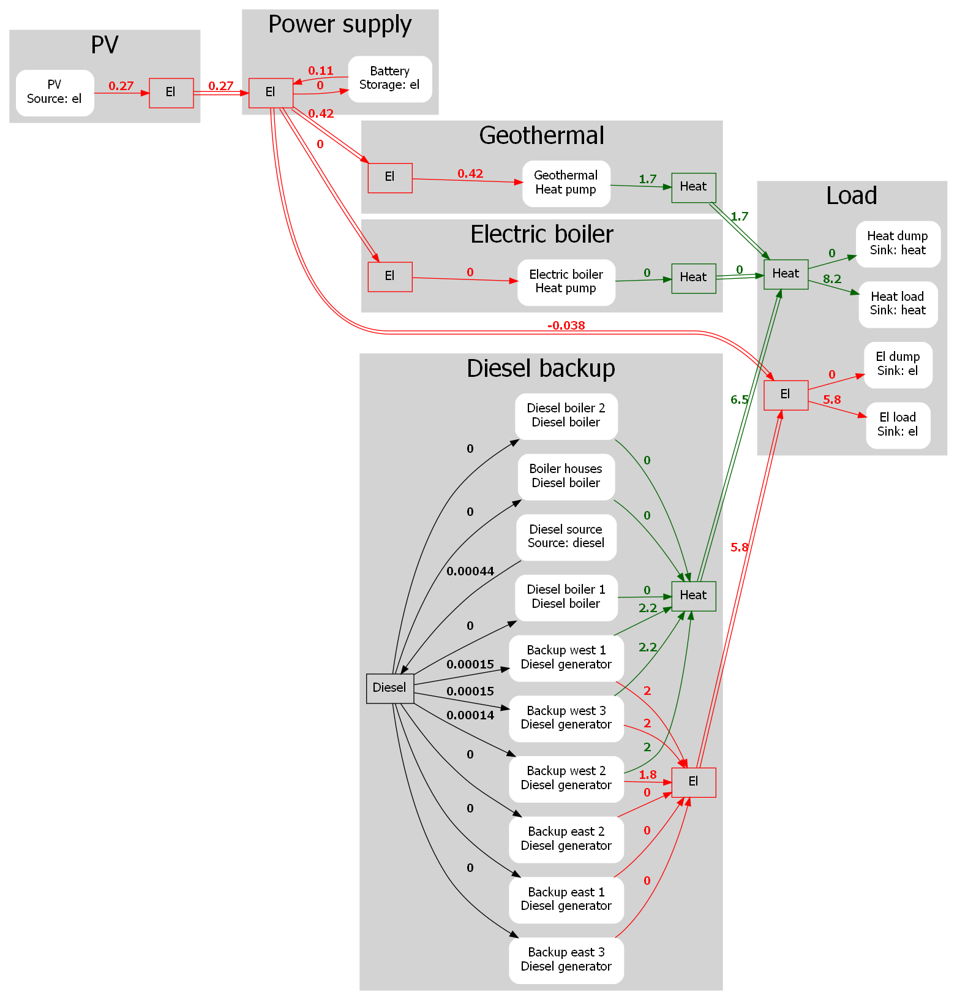

In [155]:
# Plot flow diagram for a chosen case and timestep
case_number = 3
sim = cases[case_number]
sim_name = case_names[case_number]

tstep=2563
gCombined = plots.plot_network(simulator=sim,timestep=tstep,numberformat="{:.3g}", rank_direction="LR",
                              filename=None,only_carrier=None,node_fs=30, dev_fs=15, edge_fs = 14, carrier_fs=15,fn = "DejaVu Sans", names = pretty_name_dict,
                              hide_losses=True)
#gCombined.write_pdf(path=outpath+"diagram{}.pdf".format(case))
IPython.display.Image(gCombined.create_png())

In [156]:
combine = [["Diesel generators"],[dieselgenerators]]

fig2=plots.plot_sum_power_mix(sim.result_object,sim.optimiser,carrier="el",filename=None,devs_combine=combine,exclude_zero=True,dev_color_dict=device_color_dict, names=pretty_name_dict)#,devs_shareload=dieselgenerators, exclude_zero=True)#['Gen1','Gen2','Gen3'])
#fig2.update_layout(autosize=False,width=800,height=500,margin=dict(l=0,r=0,t=0,b=0))
#fig2.write_image("{}/elpowermix{}.png".format(outpath,case))
#fig2.set_size_inches(6,4)
plt.suptitle("")
fig2.show()
plt.savefig("result/poweroutputel{}x.pdf".format(sim_name),dpi=300,bbox_inches="tight")

<Figure size 432x288 with 0 Axes>

In [157]:
combine = [["Diesel boilers", "Diesel generators"],[dieselboilers, dieselgenerators]]

fig2=plots.plot_sum_power_mix(sim.result_object,sim.optimiser,carrier="heat",filename=None,devs_combine=combine,exclude_zero=True,dev_color_dict=device_color_dict, names=pretty_name_dict)#,devs_shareload=dieselgenerators, exclude_zero=True)#['Gen1','Gen2','Gen3'])
#fig2.update_layout(autosize=False,width=800,height=500,margin=dict(l=0,r=0,t=0,b=0))
#fig2.write_image("{}/elpowermix{}.png".format(outpath,case))
#fig2.set_size_inches(6,4)
plt.suptitle("")
fig2.show()
plt.savefig("result/poweroutputheat{}x.pdf".format(sim_name),dpi=300,bbox_inches="tight")

<Figure size 432x288 with 0 Axes>

In [158]:
devices = [d for d,d_obj in sim.optimiser.all_devices.items() if d_obj.dev_data.model in ["dieselgenerator", "source_el"]]
fig=plots.plot_device_profile(sim.result_object,sim.optimiser,devs=devices,filename=None,include_on_off=True, include_prep=False,devs_shareload=None, names=pretty_name_dict)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white",
                 title="Power supply and on/off status (case: {})".format(sim_name))
fig.show()

In [159]:
devices = [d for d,d_obj in sim.optimiser.all_devices.items() if d_obj.dev_data.model in ["dieselheater", "heatpump"]]
fig=plots.plot_device_profile(sim.result_object,sim.optimiser,devs=devices,carrier="heat",filename=None,include_on_off=True, include_prep=False,devs_shareload=None, names=pretty_name_dict)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white",yaxis_title="Heat supply (MW)",
                 title="Heat supply and on/off status (case: {})".format(sim_name))
fig.show()

el      6.060887
heat    6.865116
dtype: float64


,el,heat
device,,
backup_east_1,0.000000,0.000000
backup_east_2,0.000000,0.000000
backup_east_3,0.000000,0.000000
backup_west_1,0.000000,0.000000
backup_west_2,0.000000,0.000000
backup_west_3,0.000000,0.000000
boiler_houses,0.000000,0.000000
diesel_boiler_1,0.000000,0.000000
diesel_boiler_2,0.000000,0.000000


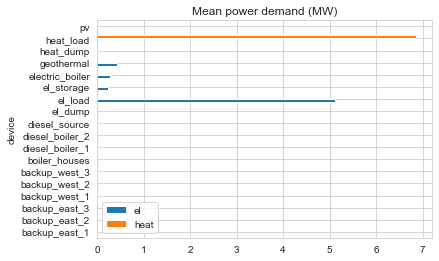

In [160]:
mean_el_demand = sim.result_object.device_flow.unstack('carrier')['el'].unstack('terminal')['in'].dropna().unstack().T.mean()
mean_heat_demand = sim.result_object.device_flow.unstack('carrier')['heat'].unstack('terminal')['in'].dropna().unstack().T.mean()
energydemand = pd.concat({'el':mean_el_demand,'heat':mean_heat_demand},axis=1)
#energydemand.drop('heatdump',inplace=True)
energydemand.plot.barh(title="Mean power demand (MW)")
print(energydemand.sum())
energydemand

In [161]:
energydemand.el.el_storage * 8760 # hours per year

1969.6503040428481

In [162]:
mean_flows=sim.result_object.device_flow.unstack(["carrier","device","terminal"]).mean().unstack(["carrier","terminal"])
print("Mean flows:\n",mean_flows.sum())
print("Mean flow per device:")
mean_flows

Mean flows:
 carrier   terminal
diesel    in          0.000322
          out         0.000322
el        in          6.060887
          out         6.060887
heat      in          6.865116
          out         6.865116
hydrogen  in          0.000000
          out         0.000000
dtype: float64
Mean flow per device:


carrier                diesel                  el                heat  \
terminal                   in       out        in       out        in   
device                                                                  
backup_east_1    1.822784e-06  0.000000  0.000000  0.023694  0.000000   
backup_east_2    1.801945e-06  0.000000  0.000000  0.023388  0.000000   
backup_east_3    1.707232e-06  0.000000  0.000000  0.022186  0.000000   
backup_west_1    1.037306e-04  0.000000  0.000000  1.368495  0.000000   
backup_west_2    1.027231e-04  0.000000  0.000000  1.355564  0.000000   
backup_west_3    1.022943e-04  0.000000  0.000000  1.349308  0.000000   
boiler_houses    8.638796e-07  0.000000  0.000000  0.000000  0.000000   
diesel_boiler_1  4.856463e-06  0.000000  0.000000  0.000000  0.000000   
diesel_boiler_2  2.641343e-06  0.000000  0.000000  0.000000  0.000000   
diesel_source    0.000000e+00  0.000322  0.000000  0.000000  0.000000   
el_dump          0.000000e+00  0.000000  0.000000  0.000000  0.000000   
el_load          0.000000e+00  0.000000  5.121251  0.000000  0.000000   
el_storage       0.000000e+00  0.000000  0.224846  0.186195  0.000000   
electric_boiler  0.000000e+00  0.000000  0.285144  0.000000  0.000000   
geothermal       0.000000e+00  0.000000  0.429646  0.000000  0.000000   
heat_dump        0.000000e+00  0.000000  0.000000  0.000000  0.009417   
heat_load        0.000000e+00  0.000000  0.000000  0.000000  6.855699   
pv               0.000000e+00  0.000000  0.000000  1.732057  0.000000   

carrier                   hydrogen       
terminal              out       in  out  
device                                   
backup_east_1    0.000000      0.0  0.0  
backup_east_2    0.000000      0.0  0.0  
backup_east_3    0.000000      0.0  0.0  
backup_west_1    1.540227      0.0  0.0  
backup_west_2    1.525051      0.0  0.0  
backup_west_3    1.519043      0.0  0.0  
boiler_houses    0.028366      0.0  0.0  
diesel_boiler_1  0.162934      0.0  0.0  
diesel_boiler_2  0.088617      0.0  0.0  
diesel_source    0.000000      0.0  0.0  
el_dump          0.000000      0.0  0.0  
el_load          0.000000      0.0  0.0  
el_storage       0.000000      0.0  0.0  
electric_boiler  0.282293      0.0  0.0  
geothermal       1.718585      0.0  0.0  
heat_dump        0.000000      0.0  0.0  
heat_load        0.000000      0.0  0.0  
pv               0.000000      0.0  0.0

In [163]:
gts = [d for d,d_obj in sim.optimiser.all_devices.items() if d_obj.dev_data.model in ["sourceel"]]
fig=plots.plot_device_profile(sim.result_object,sim.optimiser,devs=gts,filename=None,include_on_off=False,include_prep=False,devs_shareload=None, names=pretty_name_dict)
#fig.update_layout(autosize=False,width=700,height=300,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white")
fig.show()
#300 dpi and 4 inch: 1200 pixels
scale=300/96 # ratio print vs screen dpi
#fig.write_image(outpath+"powersupply.pdf",width=700,height=300,scale=scale)

In [164]:
if 'el_storage' in sim.optimiser.setDevice:
    fig=plots.plot_device_power_energy(sim.result_object,sim.optimiser,'el_storage',filename=None,dev_color_dict=device_color_dict, names=pretty_name_dict)
    fig.update_layout(autosize=False,width=800,height=300,margin=dict(l=0,r=0,t=30,b=0)).show()
#    oogeso.plots.optimization_plots.plot_device_power_last_optimisation_1(mc,device='battery', filename=None)

In [165]:
if "h2_storage" in sim.optimiser.setDevice:
    fig=plots.plot_device_power_energy(sim.result_object,sim.optimiser,hydrogenstorage[0],include_flow=False,filename=None,dev_color_dict=device_color_dict, names=pretty_name_dict, sy=True)
    fig.update_layout(autosize=False,width=600,height=350,margin=dict(l=0,r=0,t=0,b=0))
    fig.layout.font.size = 14
    fig.add_trace(go.Scatter(x=[], y=[]), secondary_y=True) 
    fig.update_layout(
        yaxis_range=(0, 1.03*max(fig.data[0].y)),
        yaxis2=dict(title='Percentage of storage capacity', overlaying="y",
                    side='right', 
                    tickformat='.1%',
                    range=(0, 1.03*max(fig.data[0].y)/sim.optimiser.all_devices["h2_storage"].dev_data.E_max),
                    #gridcolor='rgba(0, 0, 0, 0)', # transparent grid lines
                )
    )
    if save_figures:
        fig.write_image(location+"h2_storage{}.pdf".format(sim_name))
    fig.show()

In [166]:
fig=plots.plot_CO2_rate_per_device(sim.result_object,sim.optimiser,reverse_legend=True,filename=location+"co2rate_opt.png",dev_color_dict=device_color_dict, names=pretty_name_dict)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=0,b=0))

In [167]:
combine = [["Diesel generators", "Diesel boilers"],[dieselgenerators, dieselboilers]]

fig=plots.plot_CO2_rate_per_device(sim.result_object,sim.optimiser,reverse_legend=True,filename=location+"co2rate_opt_combine.png",devs_combine=combine,dev_color_dict=device_color_dict, names=pretty_name_dict)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=0,b=0))

In [168]:
fig = plots.plot_CO2_rate(sim.result_object)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=0,b=0))

In [169]:
fig = plots.plot_op_cost(sim.result_object)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=0,b=0))

In [170]:
exclude = dumpdevices + loaddevices 

fig=plots.plot_op_cost_per_device(sim.result_object,sim.optimiser,reverse_legend=True,filename=location+"co2rate_opt_combine.png",devs_combine=combine,devs_exclude=exclude,dev_color_dict=device_color_dict, names=pretty_name_dict)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=0,b=0))

In [171]:
combine = [["Diesel generators", "Diesel boilers"],[dieselgenerators, dieselboilers]]
exclude = dumpdevices + loaddevices 

fig=plots.plot_op_cost_per_device(sim.result_object,sim.optimiser,reverse_legend=True,filename=location+"co2rate_opt_combine.png",devs_combine=combine,devs_exclude=exclude,dev_color_dict=device_color_dict, names=pretty_name_dict)#,device_shareload=gts)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=0,b=0))

In [172]:
fig = plots.plot_all_costs(sim.result_object, sim.optimiser, non_inv_mult_factor=20)
fig.show()

In [173]:
exclude = dumpdevices + loaddevices 

years = 20 # assuming no extra investment costs in this period

fig = plots.plot_all_costs_per_device(sim.result_object, sim.optimiser, include_sum=True, devs_exclude=exclude, names=pretty_name_dict, divide_investment_by_lifetime=False, non_inv_mult_factor = years)
fig.show()

In [174]:
combine = [["Diesel generators", "Diesel boilers"],[dieselgenerators, dieselboilers]]
exclude = dumpdevices + loaddevices 

years = 20
if years == 1:
    y = "year"
else:
    y = "years"

fig = plots.plot_all_costs_per_device(sim.result_object, sim.optimiser, year_avg=True, include_sum=False, devs_combine=combine, annuity_interest_rate=None, devs_exclude=exclude, names=pretty_name_dict, non_inv_mult_factor=years)
fig.layout.font.size = 14
names = set()
fig.for_each_trace(
    lambda trace:
        trace.update(showlegend=False)
        if (trace.name in names) else names.add(trace.name))
fig.update_layout(
    title = "",
    xaxis_title="Devices",
    yaxis_title= "Costs for {} ".format(years) + y + " [NOK]",
    #showlegend=False,
    width=600,
    height=350,
    margin={'b':0,'r':0,'t':0,'l':0},
    )
fig.update_layout(legend=dict(
    title=None,
    orientation="h",
    yanchor="bottom",
    y=1,
    xanchor="center",
    x=0.5
))
if save_figures:
    fig.write_image(location+"cost_per_dev{}.pdf".format(sim_name))
fig.show()

In [175]:
fig=plots.plot_reserve(sim.result_object,sim.optimiser,dynamic_margin=True,include_sum=False,dev_color_dict=device_color_dict, names=pretty_name_dict)
#plt.legend(loc="upper left",bbox_to_anchor=(1,1),frameon=False)
#fig.set_size_inches(5.92,1.5)
#plt.savefig("result/reserve{}x.pdf".format(case),dpi=300,bbox_inches="tight")
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white")
fig.update_layout(legend_traceorder="reversed")
fig.show()
#300 dpi and 4 inch: 1200 pixels
#scale=300/96 # ratio print vs screen dpi
#fig.write_image(outpath+"reserve.pdf",width=700,height=200,scale=scale)

In [176]:
combine = [["Diesel generators"],[dieselgenerators]]

fig=plots.plot_reserve(sim.result_object,sim.optimiser,dynamic_margin=True,include_sum=False,devs_combine=combine,dev_color_dict=device_color_dict, names=pretty_name_dict)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white")
fig.update_layout(legend_traceorder="reversed")
fig.show()
#300 dpi and 4 inch: 1200 pixels
#scale=300/96 # ratio print vs screen dpi
#fig.write_image(outpath+"reserve.pdf",width=700,height=200,scale=scale)

In [177]:
fig=plots.plot_reserve(sim.result_object,sim.optimiser,carrier="heat",dynamic_margin=True,include_sum=False,dev_color_dict=device_color_dict, names=pretty_name_dict)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white")
fig.update_layout(legend_traceorder="reversed")
fig.show()

In [178]:
combine = [["Diesel generators", "Diesel boilers"],[dieselgenerators, dieselboilers]]

fig=plots.plot_reserve(sim.result_object,sim.optimiser,carrier="heat",dynamic_margin=True,include_sum=False,devs_combine=combine,dev_color_dict=device_color_dict, names=pretty_name_dict)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white")
fig.update_layout(legend_traceorder="reversed")
fig.show()

In [179]:
# This plot shows per device its output (dotted line) and the available online backup, iel reserve 
# by _other_ devices (solid line). MARGIN(t) = min_devices(backup(t) - output(t))
plots.plot_el_backup(sim.result_object,show_margin=True,return_margin=False, names=pretty_name_dict)

In [180]:
if "h2_storage" in sim.optimiser.setDevice:
    fig=plots.plot_device_power_energy(sim.result_object,sim.optimiser,"h2_storage", names=pretty_name_dict)
    fig.update_layout(autosize=False,width=800,height=250,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white")
    fig.update_yaxes(tick0=0, dtick=1,secondary_y=True,range=[0,5.5])
    fig.update_yaxes(tick0=0, dtick=100e3,secondary_y=False,range=[0,550e3])
    fig.show()
    #fig.write_image(location+"h2_storage{}.pdf".format(sim_name))

In [181]:
if "wind" in sim.optimiser.setDevice or "pv" in sim.optimiser.setDevice:
    fig = plots.plot_unused_profile_power(sim, names=pretty_name_dict)
    fig.show()

In [190]:
profiles = sim.profiles["nowcast"]
unused_power = []
labels = []
for d, d_obj in sim.optimiser.all_devices.items():
    if d_obj.dev_data.model == "sourceel" and d_obj.dev_data.profile is not None:
        id = d_obj.dev_data.id
        labels.append(id)
        unused_power.append(profiles[d_obj.dev_data.profile][:len(sim.result_object.device_flow[id]["el"]["out"])] * d_obj.dev_data.flow_max - sim.result_object.device_flow[id]["el"]["out"])
data = pd.DataFrame(np.array(unused_power).T, columns=labels)

In [191]:
data["pv"].mean()*8760

956.6573327202034

## Compare parameters for all cases

In [302]:
# Gather data for the current coal power plant
coal = dict()

hour_per_year = 8760

coal["kgCO2_per_year"] = 78 * 10**6
coal["elconsumption_mwh_per_year"] = simulator.profiles["nowcast"].el_load.mean() * hour_per_year
coal["heatconsumption_mwh_per_year"] = simulator.profiles["nowcast"].heat_load.mean() * hour_per_year

current = pd.DataFrame.from_dict(coal, orient='index', columns=["coal"])

In [303]:
current

,coal
kgCO2_per_year,7.800000e+07
elconsumption_mwh_per_year,4.483020e+04
heatconsumption_mwh_per_year,6.045588e+04


In [323]:
NOK_inflation_2020_2022 = 1.0584
current_costs = 60620437 + 26555069
current_costs = current_costs * NOK_inflation_2020_2022

In [324]:
current_costs

92266555.5504

In [305]:
kpi_all.rename(columns=pretty_name_dict, inplace=True)

In [306]:
simulator.result_object.device_flow.unstack("carrier")["el"].unstack("terminal")["in"].dropna().unstack().mean(axis=1).el_load*8760

44862.15621014085

In [307]:
kpi_all

,Case 1,Case 2,Case 3,Case 4,Case 5,Case 6
hours_simulated,8.520000e+03,8.520000e+03,8.520000e+03,8.520000e+03,8.520000e+03,8.520000e+03
kgCO2_per_year,3.548905e+07,3.015884e+07,1.605839e+07,4.751591e+06,3.183308e+06,0.000000e+00
kgCO2_per_Sm3oe,NaN,NaN,NaN,NaN,NaN,NaN
fuel_nm3_per_year,1.230777e+04,8.985668e+03,5.644863e+03,1.417189e+03,6.587680e+02,0.000000e+00
elconsumption_mwh_per_year,4.598082e+04,4.642095e+04,6.165794e+04,9.856692e+04,9.154583e+04,1.280319e+05
elconsumption_avg_mw,5.248952e+00,5.299196e+00,7.038578e+00,1.125193e+01,1.045044e+01,1.461551e+01
heatconsumption_mwh_per_year,6.005592e+04,6.005592e+04,6.005592e+04,6.005592e+04,6.005592e+04,6.005592e+04
heatconsumption_avg_mw,6.855699e+00,6.855699e+00,6.855699e+00,6.855699e+00,6.855699e+00,6.855699e+00
eldump_mwh_per_year,1.659532e-01,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,4.330151e+00
eldump_avg_mw,1.894443e-05,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,4.943095e-04


In [308]:
# cases[0].result_object.device_flow.el_storage.el["in"].mean()*8760

In [309]:
# cases[0].result_object.device_flow.el_storage.el.out.mean()*8760

In [310]:
kpi_all.loc[current.coal.index].values.T / current.coal.loc[current.coal.index].values
#kpi_all.div(current)

array([[0.45498776, 1.02566617, 0.9933843 ],
       [0.38665174, 1.035484  , 0.9933843 ],
       [0.20587684, 1.3753662 , 0.9933843 ],
       [0.06091783, 2.19867222, 0.9933843 ],
       [0.04081165, 2.04205713, 0.9933843 ],
       [0.        , 2.85592941, 0.9933843 ]])

In [117]:
fig = make_subplots(specs=[[{"secondary_y": True}]])
fig.add_trace(go.Bar(x=kpi_all.columns, y=kpi_all.loc["kgCO2_per_year"]))
fig.add_trace(go.Scatter(x=[], y=[], yaxis='y2'))
fig.update_traces(marker_color=device_color_dict["CO2_cost"])
fig.update_layout(
    xaxis_title="Cases",
    yaxis_title="CO<sub>2</sub> emissions per year [kg]",
    yaxis_range=(0, 1.03*max(kpi_all.loc["kgCO2_per_year"])),
    showlegend=False,
    width=812,#600,
    height=400,#350,
    margin={'b':0,'r':0,'t':0,'l':0},
    yaxis2=dict(title='Percentage of current emissions', overlaying="y",
                side='right', 
                tickformat='.1%',
                range=(0, 1.03*max(kpi_all.loc["kgCO2_per_year"])/current.coal["kgCO2_per_year"]),
                #gridcolor='rgba(0, 0, 0, 0)', # transparent grid lines
               )
    )
for i in range(len(fig.data)):
    for j in range(len(fig.data[i].x)):
        fig.data[i].x[j] = fig.data[i].x[j].replace(" +", "<br>+")
        fig.data[i].x[j] = fig.data[i].x[j].replace(" r", "<br>r")
        fig.data[i].x[j] = fig.data[i].x[j].replace(" o", "<br>o")
fig.layout.font.size = 9#14
if save_figures:
    fig.write_image(location+"/comparison/"+"co2_emissions.pdf".format(sim_name))
fig.show()
# fig.write_image(location+"/comparison/"+"co2_emissions_all.pdf".format(sim_name))

In [45]:
fig = px.bar(kpi_all.loc["kgCO2_per_year"])
fig.update_traces(marker_color=device_color_dict["CO2_cost"])
fig.update_layout(
    xaxis_title="Cases",
    yaxis_title="CO<sub>2</sub> emissions per year [kg]",
    showlegend=False,
    width=600,
    height=350,
    margin={'b':0,'r':0,'t':0,'l':0},
    )
for i in range(len(fig.data)):
    for j in range(len(fig.data[i].x)):
        fig.data[i].x[j] = fig.data[i].x[j].replace(" +", "<br>+")
        fig.data[i].x[j] = fig.data[i].x[j].replace(" r", "<br>r")
        fig.data[i].x[j] = fig.data[i].x[j].replace(" o", "<br>o")
fig.layout.font.size = 14
fig.show()

In [46]:
fully_renewable_number = 2
generator_co2 =[case.result_object.co2_rate_per_dev[dieselgenerators].mean()*hour_per_year*3600*len(dieselgenerators) for case in cases[:-fully_renewable_number]]
boiler_co2 = [case.result_object.co2_rate_per_dev[dieselboilers].mean()*hour_per_year*3600*len(dieselboilers) for case in cases[:-fully_renewable_number]]
for i in range(fully_renewable_number):
    generator_co2.append(0)
    boiler_co2.append(0)
kpi_all.loc["fossil_generator_kgCO2_per_year"] = generator_co2
kpi_all.loc["fossil_boiler_kgCO2_per_year"] = boiler_co2

In [47]:
fig = px.bar(kpi_all.loc[["fossil_generator_kgCO2_per_year", "fossil_boiler_kgCO2_per_year"]][kpi_all.loc[["fossil_generator_kgCO2_per_year", "fossil_boiler_kgCO2_per_year"]] > 0].dropna(axis=1, how='all').T, color_discrete_map=device_color_dict, barmode='group')
fig.update_layout(
    xaxis_title="Cases",
    yaxis_title="Diesel device CO<sub>2</sub> emissions per year",
    showlegend=True,
    width=600,
    height=350,
    margin={'b':0,'r':0,'t':0,'l':0},
    )
fig.update_layout(legend=dict(
    title=None,
    orientation="h",
    yanchor="bottom",
    y=1,
    xanchor="center",
    x=0.5
))
for i in range(len(fig.data)):
    for j in range(len(fig.data[i].x)):
        fig.data[i].x[j] = fig.data[i].x[j].replace(" +", "<br>+")
        fig.data[i].x[j] = fig.data[i].x[j].replace(" r", "<br>r")
        fig.data[i].x[j] = fig.data[i].x[j].replace(" o", "<br>o")
fig.layout.font.size = 14
fig.data[0].name = "Diesel generators"
fig.data[1].name = "Diesel boilers"
if save_figures:
    fig.write_image(location+"/comparison/"+"diesel_device_co2.pdf".format(sim_name))
fig.show()

In [48]:
fig = px.bar(kpi_all.loc[["fossil_generator_starts_per_year", "fossil_boiler_starts_per_year"]][kpi_all.loc[["fossil_generator_starts_per_year", "fossil_boiler_starts_per_year"]] > 0].dropna(axis=1, how='all').T, color_discrete_map=device_color_dict, barmode='group')
fig.update_layout(
    xaxis_title="Cases",
    yaxis_title="Diesel device starts per year",
    showlegend=True,
    width=600,
    height=350,
    margin={'b':0,'r':0,'t':0,'l':0},
    )
fig.update_layout(legend=dict(
    title=None,
    orientation="h",
    yanchor="bottom",
    y=1,
    xanchor="center",
    x=0.5
))
for i in range(len(fig.data)):
    for j in range(len(fig.data[i].x)):
        fig.data[i].x[j] = fig.data[i].x[j].replace(" +", "<br>+")
        fig.data[i].x[j] = fig.data[i].x[j].replace(" r", "<br>r")
        fig.data[i].x[j] = fig.data[i].x[j].replace(" o", "<br>o")
fig.layout.font.size = 14
fig.data[0].name = "Diesel generators"
fig.data[1].name = "Diesel boilers"
if save_figures:
    fig.write_image(location+"/comparison/"+"diesel_device_starts.pdf".format(sim_name))
fig.show()

In [99]:
fig = px.bar(kpi_all.loc[["fossil_generator_hoursrunning_per_year", "fossil_boiler_hoursrunning_per_year"]][kpi_all.loc[["fossil_generator_hoursrunning_per_year", "fossil_boiler_hoursrunning_per_year"]] > 0].dropna(axis=1, how='all').T, color_discrete_map=device_color_dict, barmode='group')
fig.update_layout(
    xaxis_title="Cases",
    yaxis_title="Diesel device running hours per year",
    showlegend=True,
    width=812,#600,
    height=400,#350,
    margin={'b':0,'r':0,'t':0,'l':0},
    )
fig.update_layout(legend=dict(
    title=None,
    orientation="h",
    yanchor="bottom",
    y=1,
    xanchor="center",
    x=0.5
))
for i in range(len(fig.data)):
    for j in range(len(fig.data[i].x)):
        fig.data[i].x[j] = fig.data[i].x[j].replace(" +", "<br>+")
        fig.data[i].x[j] = fig.data[i].x[j].replace(" r", "<br>r")
        fig.data[i].x[j] = fig.data[i].x[j].replace(" o", "<br>o")
fig.layout.font.size = 11#14
fig.data[0].name = "Diesel generators"
fig.data[1].name = "Diesel boilers"
if save_figures:
    fig.write_image(location+"/comparison/"+"diesel_device_hours.pdf".format(sim_name))
fig.show()
# fig.write_image(location+"/comparison/"+"diesel_device_hours_all.pdf".format(sim_name))

In [50]:
test1 = kpi_all.loc["fossil_generator_hoursrunning_per_year"][kpi_all.loc["fossil_generator_hoursrunning_per_year"] > 0] / kpi_all.loc["fossil_generator_starts_per_year"][kpi_all.loc["fossil_generator_starts_per_year"] > 0]
test2 = kpi_all.loc["fossil_boiler_hoursrunning_per_year"][kpi_all.loc["fossil_boiler_hoursrunning_per_year"] > 0] / kpi_all.loc["fossil_boiler_starts_per_year"][kpi_all.loc["fossil_boiler_starts_per_year"] > 0]
test = pd.DataFrame()
test["fossil_generators_hoursrunning_per_start"] = test1
test["fossil_boiler_hoursrunning_per_start"] = test2
test = test.T

In [100]:
fig = px.bar(test.T, color_discrete_map=device_color_dict, barmode='group')
fig.update_layout(
    xaxis_title="Cases",
    yaxis_title="Diesel device running hours per start",
    showlegend=True,
    width=812,#600,
    height=400,#350,
    margin={'b':0,'r':0,'t':0,'l':0},
    )
fig.update_layout(legend=dict(
    title=None,
    orientation="h",
    yanchor="bottom",
    y=1,
    xanchor="center",
    x=0.5
))
for i in range(len(fig.data)):
    for j in range(len(fig.data[i].x)):
        fig.data[i].x[j] = fig.data[i].x[j].replace(" +", "<br>+")
        fig.data[i].x[j] = fig.data[i].x[j].replace(" r", "<br>r")
        fig.data[i].x[j] = fig.data[i].x[j].replace(" o", "<br>o")
fig.layout.font.size = 11#14
fig.data[0].name = "Diesel generators"
fig.data[1].name = "Diesel boilers"
if save_figures:
    fig.write_image(location+"/comparison/"+"diesel_device_hours_per_start.pdf".format(sim_name))
fig.show()
# fig.write_image(location+"/comparison/"+"diesel_device_hours_per_start_all.pdf".format(sim_name))

In [52]:
test1 = kpi_all.loc["fossil_generator_kgCO2_per_year"][kpi_all.loc["fossil_generator_kgCO2_per_year"] > 0] / kpi_all.loc["fossil_generator_hoursrunning_per_year"][kpi_all.loc["fossil_generator_hoursrunning_per_year"] > 0]
test2 = kpi_all.loc["fossil_boiler_kgCO2_per_year"][kpi_all.loc["fossil_boiler_kgCO2_per_year"] > 0] / kpi_all.loc["fossil_boiler_hoursrunning_per_year"][kpi_all.loc["fossil_boiler_hoursrunning_per_year"] > 0]
test = pd.DataFrame()
test["fossil_generators_kgCO2_per_hoursrunning"] = test1
test["fossil_boilers_kgCO2_per_hoursrunning"] = test2
test = test.T

In [53]:
fig = px.bar(test.T, color_discrete_map=device_color_dict, barmode='group')
fig.update_layout(
    xaxis_title="Cases",
    yaxis_title="Device CO<sub>2</sub> emissions per hour [kg/h]",
    showlegend=True,
    width=600,
    height=350,
    margin={'b':0,'r':0,'t':0,'l':0},
    )
fig.update_layout(legend=dict(
    title=None,
    orientation="h",
    yanchor="bottom",
    y=1,
    xanchor="center",
    x=0.5
))
for i in range(len(fig.data)):
    for j in range(len(fig.data[i].x)):
        fig.data[i].x[j] = fig.data[i].x[j].replace(" +", "<br>+")
        fig.data[i].x[j] = fig.data[i].x[j].replace(" r", "<br>r")
        fig.data[i].x[j] = fig.data[i].x[j].replace(" o", "<br>o")
fig.layout.font.size = 14
fig.data[0].name = "Diesel generators"
fig.data[1].name = "Diesel boilers"
if save_figures:
    fig.write_image(location+"/comparison/"+"diesel_device_co2_per_hour.pdf".format(sim_name))
fig.show()

In [54]:
fig = px.bar(kpi_all.loc["fossil_generator_starts_per_year"])
fig.update_traces(marker_color=device_color_dict["backup_west_1"])
fig.update_layout(
    xaxis_title="Cases",
    yaxis_title="Diesel generator starts per year",
    showlegend=False,
    width=600,
    height=350,
    margin={'b':0,'r':0,'t':0,'l':0},
    )
for i in range(len(fig.data)):
    for j in range(len(fig.data[i].x)):
        fig.data[i].x[j] = fig.data[i].x[j].replace(" +", "<br>+")
#fig.show()

In [55]:
fig = make_subplots(specs=[[{"secondary_y": True}]])
fig.add_trace(go.Bar(x=kpi_all.columns, y=kpi_all.loc["elconsumption_mwh_per_year"]))
fig.add_trace(go.Scatter(x=[], y=[], yaxis='y2'))
fig.update_traces(marker_color=device_color_dict["el_storage"])
fig.update_layout(
    xaxis_title="Cases",
    yaxis_title= "Electricity usage per year [MWh]",
    yaxis_range=(0, 1.03*max(kpi_all.loc["elconsumption_mwh_per_year"])),
    showlegend=False,
    width=600,
    height=350,
    margin={'b':0,'r':0,'t':0,'l':0},
    yaxis2=dict(title='Percentage of current usage', overlaying="y",
                side='right', 
                tickformat='.1%',
                range=(0, 1.03*max(kpi_all.loc["elconsumption_mwh_per_year"])/current.coal["elconsumption_mwh_per_year"]),
                #gridcolor='rgba(0, 0, 0, 0)', # transparent grid lines
               )
    )
for i in range(len(fig.data)):
    for j in range(len(fig.data[i].x)):
        fig.data[i].x[j] = fig.data[i].x[j].replace(" +", "<br>+")
        fig.data[i].x[j] = fig.data[i].x[j].replace(" r", "<br>r")
        fig.data[i].x[j] = fig.data[i].x[j].replace(" o", "<br>o")
fig.layout.font.size = 14
if save_figures:
    fig.write_image(location+"/comparison/"+"el_consumption.pdf".format(sim_name))
fig.show()

In [56]:
fig = px.bar(kpi_all.loc["elconsumption_mwh_per_year"])
fig.update_traces(marker_color=device_color_dict["el_storage"])
fig.update_layout(
    xaxis_title="Cases",
    yaxis_title= "Electricity usage per year [MWh]",
    showlegend=False,
    width=600,
    height=350,
    margin={'b':0,'r':0,'t':0,'l':0},
    )
for i in range(len(fig.data)):
    for j in range(len(fig.data[i].x)):
        fig.data[i].x[j] = fig.data[i].x[j].replace(" +", "<br>+")
        fig.data[i].x[j] = fig.data[i].x[j].replace(" r", "<br>r")
        fig.data[i].x[j] = fig.data[i].x[j].replace(" o", "<br>o")
fig.layout.font.size = 14
fig.show()

In [57]:
fig = px.bar(kpi_all.loc["eldump_mwh_per_year"])
fig.update_traces(marker_color=device_color_dict["el_storage"])
fig.update_layout(
    xaxis_title="Cases",
    yaxis_title= "Curtailed electric energy per year [MWh]",
    showlegend=False,
    width=600,
    height=400,
    margin={'b':0,'r':0,'t':0,'l':0},
    )
for i in range(len(fig.data)):
    for j in range(len(fig.data[i].x)):
        fig.data[i].x[j] = fig.data[i].x[j].replace(" +", "<br>+")
        fig.data[i].x[j] = fig.data[i].x[j].replace(" r", "<br>r")
        fig.data[i].x[j] = fig.data[i].x[j].replace(" o", "<br>o")
fig.layout.font.size = 14
fig.show()

In [58]:
fig = make_subplots(specs=[[{"secondary_y": True}]])
fig.add_trace(go.Bar(x=kpi_all.columns, y=kpi_all.loc["heatconsumption_mwh_per_year"]))
fig.add_trace(go.Scatter(x=[], y=[], yaxis='y2'))
fig.update_traces(marker_color=device_color_dict["heat_load"])
fig.update_layout(
    xaxis_title="Cases",
    yaxis_title= "Heat usage per year [MWh]",
    showlegend=False,
    width=600,
    height=350,
    margin={'b':0,'r':0,'t':0,'l':0},
    yaxis2=dict(title='Percentage of current usage', overlaying="y",
                side='right', 
                tickformat='.1%',
                range=(0, max(kpi_all.loc["heatconsumption_mwh_per_year"])/current.coal["heatconsumption_mwh_per_year"]),
                #gridcolor='rgba(0, 0, 0, 0)', # transparent grid lines
               )
    )
for i in range(len(fig.data)):
    for j in range(len(fig.data[i].x)):
        fig.data[i].x[j] = fig.data[i].x[j].replace(" +", "<br>+")
        fig.data[i].x[j] = fig.data[i].x[j].replace(" r", "<br>r")
        fig.data[i].x[j] = fig.data[i].x[j].replace(" o", "<br>o")
fig.layout.font.size = 14
fig.show()

In [59]:
fig = px.bar(kpi_all.loc["heatconsumption_mwh_per_year"])
fig.update_traces(marker_color=device_color_dict["heat_load"])
fig.update_layout(
    xaxis_title="Cases",
    yaxis_title= "Heat usage per year [MWh]",
    showlegend=False,
    width=600,
    height=350,
    margin={'b':0,'r':0,'t':0,'l':0},
    )
for i in range(len(fig.data)):
    for j in range(len(fig.data[i].x)):
        fig.data[i].x[j] = fig.data[i].x[j].replace(" +", "<br>+")
        fig.data[i].x[j] = fig.data[i].x[j].replace(" r", "<br>r")
        fig.data[i].x[j] = fig.data[i].x[j].replace(" o", "<br>o")
fig.layout.font.size = 14
fig.show()

In [312]:
test3 = 1 - (kpi_all.loc["fossil_generator_el_mwh_per_year"] + kpi_all.loc["fossil_generator_heat_mwh_per_year"] + kpi_all.loc["fossil_boiler_heat_mwh_per_year"]) / (kpi_all.loc["elconsumption_mwh_per_year"] + kpi_all.loc["heatconsumption_mwh_per_year"] + kpi_all.loc["eldump_mwh_per_year"] + kpi_all.loc["heatdump_mwh_per_year"])
#test2 = kpi_all.loc["fossil_boiler_kgCO2_per_year"] / kpi_all.loc["fossil_boiler_hoursrunning_per_year"]
test4 = pd.DataFrame()
test4["renewable_share_of_energy"] = test3
#test["fossil_boilers_kgCO2_per_hoursrunning"] = test2
test4 = test4.T

In [313]:
test4

,Case 1,Case 2,Case 3,Case 4,Case 5,Case 6
renewable_share_of_energy,0.008656,0.12712,0.605367,0.907586,0.932244,1.0


In [314]:
fig = make_subplots(specs=[[{"secondary_y": True}]])
fig.add_trace(go.Bar(x=kpi_all.columns, y=kpi_all.loc["elconsumption_mwh_per_year"], marker_color=device_color_dict["el_storage"]))
fig.add_trace(go.Bar(x=kpi_all.columns, y=kpi_all.loc["heatconsumption_mwh_per_year"], marker_color=device_color_dict["heat_load"]))
fig.add_trace(go.Scatter(x=test4.columns, y=test4.T["renewable_share_of_energy"], yaxis='y2', name= "Renewable share", showlegend=False, marker_color="#00008b"))
fig.update_layout(
    xaxis_title="Cases",
    yaxis_title= "Energy usage per year [MWh]",
    yaxis_range=(0, 1.03*(max(kpi_all.loc["elconsumption_mwh_per_year"]) + max(kpi_all.loc["heatconsumption_mwh_per_year"]))),
    #showlegend=False,
    barmode="stack",
    width=600,#812,#600,
    height=350,#400,#350,
    margin={'b':0,'r':0,'t':0,'l':0},
    yaxis2=dict(title='Renewable share', overlaying="y",
        color="#00008b",
        side='right', 
        tickformat='.1%',
        range=(0, 1.03),
        gridcolor='rgba(0, 0, 0, 0)', # transparent grid lines
        )
    )
for i in range(len(fig.data)):
    for j in range(len(fig.data[i].x)):
        fig.data[i].x[j] = fig.data[i].x[j].replace(" +", "<br>+")
        fig.data[i].x[j] = fig.data[i].x[j].replace(" r", "<br>r")
        fig.data[i].x[j] = fig.data[i].x[j].replace(" o", "<br>o")
fig.layout.font.size = 14#8.5#14
fig.update_layout(legend=dict(
    title=None,
    orientation="h",
    yanchor="bottom",
    y=1,
    xanchor="center",
    x=0.5
))
fig.data[0].name = "Electricity"
fig.data[1].name = "Heat"
if save_figures:
    fig.write_image(location+"/comparison/"+"renewable_energy_share.pdf".format(sim_name))
fig.show()
# fig.write_image(location+"/comparison/"+"renewable_energy_share_all.pdf".format(sim_name))

In [63]:
fig = px.bar(kpi_all.loc["heatdump_mwh_per_year"])
fig.update_traces(marker_color=device_color_dict["heat_load"])
fig.update_layout(
    xaxis_title="Cases",
    yaxis_title= "Curtailed heat energy year [MWh]",
    showlegend=False,
    width=600,
    height=350,
    margin={'b':0,'r':0,'t':0,'l':0},
    )
for i in range(len(fig.data)):
    for j in range(len(fig.data[i].x)):
        fig.data[i].x[j] = fig.data[i].x[j].replace(" +", "<br>+")
        fig.data[i].x[j] = fig.data[i].x[j].replace(" r", "<br>r")
        fig.data[i].x[j] = fig.data[i].x[j].replace(" o", "<br>o")
fig.layout.font.size = 14
if save_figures:
    fig.write_image(location+"/comparison/"+"heatdump.pdf".format(sim_name))
fig.show()

In [64]:
fig = px.bar(kpi_all.loc["pv_curtailed_mwh_per_year"], color_discrete_map=device_color_dict)
fig.update_layout(
    xaxis_title="Cases",
    yaxis_title= "Curtailed PV production per year [MWh]",
    showlegend=False,
    width=600,
    height=400,
    margin={'b':0,'r':0,'t':0,'l':0},
    )
for i in range(len(fig.data)):
    for j in range(len(fig.data[i].x)):
        fig.data[i].x[j] = fig.data[i].x[j].replace(" +", "<br>+")
        fig.data[i].x[j] = fig.data[i].x[j].replace(" r", "<br>r")
        fig.data[i].x[j] = fig.data[i].x[j].replace(" o", "<br>o")
fig.layout.font.size = 14
fig.show()

In [65]:
fig = px.bar(kpi_all.loc["pv_curtailed_mwh_per_year"][kpi_all.loc["pv_curtailed_mwh_per_year"] > 0], color_discrete_map=device_color_dict)
fig.update_layout(
    xaxis_title="Cases",
    yaxis_title= "Curtailed PV production per year [MWh]",
    showlegend=False,
    width=600,
    height=400,
    margin={'b':0,'r':0,'t':0,'l':0},
    )
for i in range(len(fig.data)):
    for j in range(len(fig.data[i].x)):
        fig.data[i].x[j] = fig.data[i].x[j].replace(" +", "<br>+")
        fig.data[i].x[j] = fig.data[i].x[j].replace(" r", "<br>r")
        fig.data[i].x[j] = fig.data[i].x[j].replace(" o", "<br>o")
fig.layout.font.size = 14
fig.show()

In [66]:
fig = px.bar(kpi_all.loc["wind_curtailed_mwh_per_year"], color_discrete_map=device_color_dict)
fig.update_layout(
    xaxis_title="Cases",
    yaxis_title= "Curtailed wind production per year [MWh]",
    showlegend=False,
    width=600,
    height=400,
    margin={'b':0,'r':0,'t':0,'l':0},
    )
for i in range(len(fig.data)):
    for j in range(len(fig.data[i].x)):
        fig.data[i].x[j] = fig.data[i].x[j].replace(" +", "<br>+")
        fig.data[i].x[j] = fig.data[i].x[j].replace(" r", "<br>r")
        fig.data[i].x[j] = fig.data[i].x[j].replace(" o", "<br>o")
fig.layout.font.size = 14
fig.show()

In [67]:
fig = px.bar(kpi_all.loc["wind_curtailed_mwh_per_year"][kpi_all.loc["wind_curtailed_mwh_per_year"] > 0], color_discrete_map=device_color_dict)
fig.update_layout(
    xaxis_title="Cases",
    yaxis_title= "Curtailed wind production per year [MWh]",
    showlegend=False,
    width=600,
    height=350,
    margin={'b':0,'r':0,'t':0,'l':0},
    )

In [68]:
fig = px.bar(kpi_all.loc[["pv_curtailed_mwh_per_year", "wind_curtailed_mwh_per_year"]].T, color_discrete_map=device_color_dict)
fig.update_layout(
    xaxis_title="Cases",
    yaxis_title= "Curtailed renewable energy per year [MWh]",
    showlegend=True,
    width=600,
    height=400,
    margin={'b':0,'r':0,'t':0,'l':0},
    )
fig.update_layout(legend=dict(
    title=None,
    orientation="h",
    yanchor="bottom",
    y=1,
    xanchor="center",
    x=0.5
))
for i in range(len(fig.data)):
    for j in range(len(fig.data[i].x)):
        fig.data[i].x[j] = fig.data[i].x[j].replace(" +", "<br>+")
        fig.data[i].x[j] = fig.data[i].x[j].replace(" r", "<br>r")
        fig.data[i].x[j] = fig.data[i].x[j].replace(" o", "<br>o")
fig.layout.font.size = 14
fig.data[0].name = "Curtailed PV energy"
fig.data[1].name = "Curtailed wind energy"
fig.show()

In [107]:
fig = px.bar(kpi_all.loc[["pv_curtailed_mwh_per_year", "wind_curtailed_mwh_per_year"]][kpi_all.loc[["pv_curtailed_mwh_per_year", "wind_curtailed_mwh_per_year"]] > 0].dropna(axis=1, how='all').T, color_discrete_map=device_color_dict)#, barmode='group')
fig.update_layout(
    xaxis_title="Cases",
    yaxis_title= "Curtailed renewable energy per year [MWh]",
    showlegend=True,
    width=812,#600,
    height=400,
    margin={'b':0,'r':0,'t':0,'l':0},
    )
fig.update_layout(legend=dict(
    title=None,
    orientation="h",
    yanchor="bottom",
    y=1,
    xanchor="center",
    x=0.5
))
for i in range(len(fig.data)):
    for j in range(len(fig.data[i].x)):
        fig.data[i].x[j] = fig.data[i].x[j].replace(" +", "<br>+")
        fig.data[i].x[j] = fig.data[i].x[j].replace(" r", "<br>r")
        fig.data[i].x[j] = fig.data[i].x[j].replace(" o", "<br>o")
fig.layout.font.size = 12
fig.data[0].name = "Curtailed PV energy"
fig.data[1].name = "Curtailed wind energy"
if save_figures:
    fig.write_image(location+"/comparison/"+"curtailed_energy.pdf".format(sim_name))
fig.show()
# fig.write_image(location+"/comparison/"+"curtailed_energy_all.pdf".format(sim_name))

In [70]:
fig = px.bar(kpi_all.loc["hydrogen_production_nm3_per_year"], color_discrete_map=device_color_dict)
#fig.update_traces(marker_color=device_color_dict["el_storage"])
fig.update_layout(
    xaxis_title="Cases",
    yaxis_title= "Hydrogen production per year [Nm<sup>3</sup>]",
    showlegend=False,
    width=600,
    height=350,
    margin={'b':0,'r':0,'t':0,'l':0},
    )
for i in range(len(fig.data)):
    for j in range(len(fig.data[i].x)):
        fig.data[i].x[j] = fig.data[i].x[j].replace(" +", "<br>+")
        fig.data[i].x[j] = fig.data[i].x[j].replace(" r", "<br>r")
        fig.data[i].x[j] = fig.data[i].x[j].replace(" o", "<br>o")
fig.layout.font.size = 14
fig.show()

In [71]:
fig = px.bar(kpi_all.loc["hydrogen_production_nm3_per_year"][kpi_all.loc["hydrogen_production_nm3_per_year"] > 0], color_discrete_map=device_color_dict)
#fig.update_traces(marker_color=device_color_dict["el_storage"])
fig.update_layout(
    xaxis_title="Cases",
    yaxis_title= "Hydrogen production per year [Nm<sup>3</sup>]",
    showlegend=False,
    width=600,
    height=350,
    margin={'b':0,'r':0,'t':0,'l':0},
    )
for i in range(len(fig.data)):
    for j in range(len(fig.data[i].x)):
        fig.data[i].x[j] = fig.data[i].x[j].replace(" +", "<br>+")
        fig.data[i].x[j] = fig.data[i].x[j].replace(" r", "<br>r")
        fig.data[i].x[j] = fig.data[i].x[j].replace(" o", "<br>o")
fig.layout.font.size = 14
if save_figures:
    fig.write_image(location+"/comparison/"+"h2_production.pdf".format(sim_name))
fig.show()

In [52]:
cases[0].result_object.device_flow.diesel_source.diesel.out.mean()*3600*8760

13499.066277159567

In [322]:
number = 5
electrolyser_el_in = cases[number].result_object.device_flow.electrolyser.el["in"].mean()*hour_per_year
fuelcell_el_out = cases[number].result_object.device_flow.fuelcell.el["out"].mean()*hour_per_year
electrolyser_heat_out = cases[number].result_object.device_flow.electrolyser.heat["in"].mean()*hour_per_year
fuelcell_heat_out = cases[number].result_object.device_flow.fuelcell.heat["out"].mean()*hour_per_year
storage_el_in = cases[number].result_object.device_flow.h2_storage.el["in"].mean()*hour_per_year
storage_heat_out = cases[number].result_object.device_flow.h2_storage.heat["out"].mean()*hour_per_year

el_loss = (electrolyser_el_in + storage_el_in - fuelcell_el_out) / (electrolyser_el_in + storage_el_in)
energy_loss = (electrolyser_el_in + storage_el_in - fuelcell_el_out - electrolyser_heat_out - fuelcell_heat_out - storage_heat_out) / (electrolyser_el_in + storage_el_in)
print(1-el_loss)
print(1-energy_loss)

0.3595864531721178
0.6497961136289194


In [205]:
plots.plot_all_losses(cases[number].result_object, cases[nymber], pv_devs = pvdevices, wind_devs = winddevices, battery_devs = batterydevices, eboiler_devs = electricboilerdevices, h2_devs = hydrogenelectrolyser + hydrogenfuelcell + hydrogenstorage)

In [ ]:
el_loss_devices = ["Battery round-trip loss"]
el_loss = []
for i in range(len(cases)):

    # Loss in battery
    if batterydevices[0] in cases[i].optimiser.setDevice:
        battery_el_in = cases[i].result_object.device_flow.unstack("device")[batterydevices].T.el["in"].T.mean().sum()*hour_per_year
        battery_el_out = cases[i].result_object.device_flow.unstack("device")[batterydevices].T.el["out"].T.mean().sum()*hour_per_year

        battery_el_loss = battery_el_in - battery_el_out
        battery_energy_loss = battery_el_in - battery_el_out
        battery_el_loss_fraction = (battery_el_in - battery_el_out) / (battery_el_in)
        battery_energy_loss_fraction = (battery_el_in - battery_el_out) / (battery_el_in)

        

    # Loss in hydrogen system
    if hydrogendevices[0] in cases[i].optimiser.setDevice:
        h2_el_in = cases[i].result_object.device_flow.unstack("device")[hydrogenelectrolyser + hydrogenfuelcell + hydrogenstorage].T.el["in"].T.mean().sum()*hour_per_year
        h2_el_out = cases[i].result_object.device_flow.unstack("device")[hydrogenelectrolyser + hydrogenfuelcell + hydrogenstorage].T.el["out"].T.mean().sum()*hour_per_year
        h2_heat_out = cases[i].result_object.device_flow.unstack("device")[hydrogenelectrolyser + hydrogenfuelcell + hydrogenstorage].T.heat["out"].T.mean().sum()*hour_per_year

        h2_el_loss = h2_el_in - h2_el_out
        h2_energy_loss = h2_el_in - h2_el_out - h2_heat_out
        h2_el_loss_fraction = (h2_el_in - h2_el_out) / (h2_el_in)
        h2_energy_loss_fraction = (h2_el_in - h2_el_out - h2_heat_out) / (h2_el_in)



In [343]:
fig = px.bar() 
highest_loss = 0
for num in range(len(cases)):
    newfig = plots.plot_all_losses(cases[num].result_object, cases[num], pv_devs = pvdevices, wind_devs = winddevices, battery_devs = batterydevices, eboiler_devs = electricboilerdevices, h2_devs = hydrogenelectrolyser + hydrogenfuelcell + hydrogenstorage, heat_dump_devs = heatdumpdevices)
    for i in range(len(newfig.data)):
        for j in range(len(newfig.data[i].x)):
            newfig.data[i].x[j] = pretty_name_dict[case_names[num]].replace(" +", "<br>+")
            newfig.data[i].x[j] = newfig.data[i].x[j].replace(" r", "<br>r")
            newfig.data[i].x[j] = newfig.data[i].x[j].replace(" o", "<br>o")
    fig.add_traces(newfig.data)
    highest_loss = max(highest_loss, np.array([bar["y"] for bar in newfig.data]).sum())
total_losses = []
labels = []
for bar in fig.data:
    if bar.x not in labels:
        labels.append(bar.x[0])
        total_losses.append(0)
    total_losses[len(labels)-1] += bar.y[0].sum()
total_production = (kpi_all.loc["fossil_generator_el_mwh_per_year"] + kpi_all.loc["fossil_generator_heat_mwh_per_year"] + kpi_all.loc["fossil_boiler_heat_mwh_per_year"] + kpi_all.loc["pv_output_mwh_per_year"] + kpi_all.loc["wind_output_mwh_per_year"]).values
total_losses = total_losses / total_production
fig.add_trace(go.Scatter(x=labels, y=total_losses, yaxis='y2', name= "Percent of total production", showlegend=False, marker_color="#00008b"))
fig.layout.font.size = 8.5#14#8.5
names = set()
fig.for_each_trace(
    lambda trace:
        trace.update(showlegend=False)
        if (trace.name in names) else names.add(trace.name))
fig.update_layout(
    xaxis_title="Cases",
    yaxis_title= "Energy loss per year [MWh]",
    #showlegend=False,
    width=812,#600,
    height=400,#350,
    yaxis_range=(0, 1.03*highest_loss),
    margin={'b':0,'r':0,'t':0,'l':0},
    yaxis2=dict(title='Percentage of produced energy', overlaying="y",
                color="#00008b",
                side='right', 
                tickformat='.1%',
                range=(0, 1.03*max(total_losses)),
                #gridcolor='rgba(0, 0, 0, 0)', # transparent grid lines
               )
)
fig.update_layout(legend=dict(
    title=None,
    orientation="h",
    yanchor="bottom",
    y=1,
    xanchor="center",
    x=0.5
))
if save_figures:
    fig.write_image(location+"/comparison/"+"energy_loss_per_year.pdf")
fig.show()
# fig.write_image(location+"/comparison/"+"energy_loss_per_year_all.pdf")

In [72]:
fig = px.bar() #plots.plot_all_costs(cases[0].result_object, cases[0].optimiser)
for num in range(len(cases)):
    newfig = plots.plot_all_costs(cases[num].result_object, cases[num].optimiser)
    for i in range(len(newfig.data)):
        for j in range(len(newfig.data[i].x)):
            newfig.data[i].x[j] = pretty_name_dict[case_names[num]].replace(" +", "<br>+")
            newfig.data[i].x[j] = newfig.data[i].x[j].replace(" r", "<br>r")
            newfig.data[i].x[j] = newfig.data[i].x[j].replace(" o", "<br>o")
    fig.add_traces(newfig.data)
fig.layout.font.size = 14
names = set()
fig.for_each_trace(
    lambda trace:
        trace.update(showlegend=False)
        if (trace.name in names) else names.add(trace.name))
fig.update_layout(
    xaxis_title="Cases",
    yaxis_title= "Costs per year [NOK]",
    #showlegend=False,
    width=1200,
    height=500,
    margin={'b':0,'r':0,'t':0,'l':0},
    )
fig.update_layout(legend=dict(
    title=None,
    orientation="h",
    yanchor="bottom",
    y=1,
    xanchor="center",
    x=0.5
))
fig.show()

In [73]:
fig = px.bar() #plots.plot_all_costs(cases[0].result_object, cases[0].optimiser)
for num in range(len(cases)):
    newfig = plots.plot_all_costs(cases[num].result_object, cases[num].optimiser, year_avg=True, divide_investment_by_lifetime=True)
    for i in range(len(newfig.data)):
        for j in range(len(newfig.data[i].x)):
            newfig.data[i].x[j] = pretty_name_dict[case_names[num]].replace(" +", "<br>+")
            newfig.data[i].x[j] = newfig.data[i].x[j].replace(" r", "<br>r")
            newfig.data[i].x[j] = newfig.data[i].x[j].replace(" o", "<br>o")
    fig.add_traces(newfig.data)
fig.layout.font.size = 14
names = set()
fig.for_each_trace(
    lambda trace:
        trace.update(showlegend=False)
        if (trace.name in names) else names.add(trace.name))
fig.update_layout(
    xaxis_title="Cases",
    yaxis_title= "Costs per year [NOK]",
    #showlegend=False,
    width=600,
    height=350,
    margin={'b':0,'r':0,'t':0,'l':0},
    )
fig.update_layout(legend=dict(
    title=None,
    orientation="h",
    yanchor="bottom",
    y=1,
    xanchor="center",
    x=0.5
))
if save_figures:
    fig.write_image(location+"/comparison/"+"cost_per_year.pdf".format(sim_name))
fig.show()

In [110]:
fig = px.bar() #plots.plot_all_costs(cases[0].result_object, cases[0].optimiser)
for num in range(len(cases)):
    newfig = plots.plot_all_costs(cases[num].result_object, cases[num].optimiser, year_avg=True, annuity_interest_rate = 0.04)
    for i in range(len(newfig.data)):
        for j in range(len(newfig.data[i].x)):
            newfig.data[i].x[j] = pretty_name_dict[case_names[num]].replace(" +", "<br>+")
            newfig.data[i].x[j] = newfig.data[i].x[j].replace(" r", "<br>r")
            newfig.data[i].x[j] = newfig.data[i].x[j].replace(" o", "<br>o")
    fig.add_traces(newfig.data)
fig.layout.font.size = 9
names = set()
fig.for_each_trace(
    lambda trace:
        trace.update(showlegend=False)
        if (trace.name in names) else names.add(trace.name))
fig.update_layout(
    xaxis_title="Cases",
    yaxis_title= "Costs per year [NOK]",
    #showlegend=False,
    width=812,#600,
    height=400,#350,
    margin={'b':0,'r':0,'t':0,'l':0},
    )
fig.update_layout(legend=dict(
    title=None,
    orientation="h",
    yanchor="bottom",
    y=1,
    xanchor="center",
    x=0.5
))
# if save_figures:
#     fig.write_image(location+"/comparison/"+"cost_per_year_annualized.pdf".format(sim_name))
fig.show()
# fig.write_image(location+"/comparison/"+"cost_per_year_annualized_all.pdf".format(sim_name))

In [341]:
#fig = make_subplots(specs=[[{"secondary_y": True}]])
fig = px.bar() #plots.plot_all_costs(cases[0].result_object, cases[0].optimiser)
highest_cost = 0
for num in range(len(cases)):
    newfig = plots.plot_all_costs(cases[num].result_object, cases[num].optimiser, year_avg=True, annuity_interest_rate = 0.04)
    for i in range(len(newfig.data)):
        for j in range(len(newfig.data[i].x)):
            newfig.data[i].x[j] = pretty_name_dict[case_names[num]].replace(" +", "<br>+")
            newfig.data[i].x[j] = newfig.data[i].x[j].replace(" r", "<br>r")
            newfig.data[i].x[j] = newfig.data[i].x[j].replace(" o", "<br>o")
    fig.add_traces(newfig.data)
    highest_cost = max(highest_cost, np.array([bar["y"] for bar in newfig.data]).sum())
fig.add_trace(go.Scatter(x=[], y=[], yaxis='y2'))
fig.layout.font.size = 8.5#13#8.5
names = set()
fig.for_each_trace(
    lambda trace:
        trace.update(showlegend=False)
        if (trace.name in names) else names.add(trace.name))
fig.update_layout(
    xaxis_title="Cases",
    yaxis_title= "Costs per year [NOK]",
    #showlegend=False,
    width=812,#600,
    height=400,#350,
    yaxis_range=(0, 1.03*highest_cost),
    margin={'b':0,'r':0,'t':0,'l':0},
    yaxis2=dict(title='Percentage of current cost', overlaying="y",
                side='right', 
                tickformat='.1%',
                range=(0, 1.03*highest_cost/current_costs),
                #gridcolor='rgba(0, 0, 0, 0)', # transparent grid lines
               )
)
fig.update_layout(legend=dict(
    title=None,
    orientation="h",
    yanchor="bottom",
    y=1,
    xanchor="center",
    x=0.5
))
if save_figures:
    fig.write_image(location+"/comparison/"+"cost_per_year_annualized.pdf")
fig.show()
# fig.write_image(location+"/comparison/"+"cost_per_year_annualized_all.pdf")

In [106]:
fig = px.bar()
years = 20
for num in range(len(cases)):
    newfig = plots.plot_all_costs(cases[num].result_object, cases[num].optimiser, year_avg=True, divide_investment_by_lifetime=False, non_inv_mult_factor = years)
    for i in range(len(newfig.data)):
        for j in range(len(newfig.data[i].x)):
            newfig.data[i].x[j] = pretty_name_dict[case_names[num]].replace(" +", "<br>+")
            newfig.data[i].x[j] = newfig.data[i].x[j].replace(" r", "<br>r")
            newfig.data[i].x[j] = newfig.data[i].x[j].replace(" o", "<br>o")
    fig.add_traces(newfig.data)
fig.layout.font.size = 9
names = set()
fig.for_each_trace(
    lambda trace:
        trace.update(showlegend=False)
        if (trace.name in names) else names.add(trace.name))
fig.update_layout(
    xaxis_title="Cases",
    yaxis_title= "Costs for {} years [NOK]".format(years),
    #showlegend=False,
    width=812,#600,
    height=400,#310,
    margin={'b':0,'r':0,'t':0,'l':0},
    )
fig.update_layout(legend=dict(
    title=None,
    orientation="h",
    yanchor="bottom",
    y=1,
    xanchor="center",
    x=0.5
))
if save_figures:
    fig.write_image(location+"/comparison/"+"cost_for_{}_years.pdf".format(years))
fig.show()
# fig.write_image(location+"/comparison/"+"cost_for_{}_years_all.pdf".format(years))

In [339]:
fig = px.bar() #plots.plot_all_costs(cases[0].result_object, cases[0].optimiser)
highest_cost = 0
for num in range(len(cases)):
    newfig = plots.plot_all_costs(cases[num].result_object, cases[num].optimiser, year_avg=True, investment=False)
    for i in range(len(newfig.data)):
        for j in range(len(newfig.data[i].x)):
            newfig.data[i].x[j] = pretty_name_dict[case_names[num]].replace(" +", "<br>+")
            newfig.data[i].x[j] = newfig.data[i].x[j].replace(" r", "<br>r")
            newfig.data[i].x[j] = newfig.data[i].x[j].replace(" o", "<br>o")
    fig.add_traces(newfig.data)
    highest_cost = max(highest_cost, np.array([bar["y"] for bar in plots.plot_all_costs(cases[num].result_object, cases[num].optimiser, year_avg=True, annuity_interest_rate = 0.04).data]).sum())
fig.add_trace(go.Scatter(x=[], y=[], yaxis='y2'))
fig.layout.font.size = 8.5#14#8.5
names = set()
fig.for_each_trace(
    lambda trace:
        trace.update(showlegend=False)
        if (trace.name in names) else names.add(trace.name))
fig.update_layout(
    xaxis_title="Cases",
    yaxis_title= "Costs per year [NOK]",
    #showlegend=False,
    width=812,#600,
    height=400,#350,
    margin={'b':0,'r':0,'t':0,'l':0},
    yaxis_range=(0, 1.03*highest_cost),
    yaxis2=dict(title='Percentage of current costs', overlaying="y",
                side='right', 
                tickformat='.1%',
                range=(0, 1.03*highest_cost/current_costs),
                #gridcolor='rgba(0, 0, 0, 0)', # transparent grid lines
               )
    )
fig.update_layout(legend=dict(
    title=None,
    orientation="h",
    yanchor="bottom",
    y=1,
    xanchor="center",
    x=0.5
))
if save_figures:
    fig.write_image(location+"/comparison/"+"om_cost_per_year.pdf")
fig.show()
# fig.write_image(location+"/comparison/"+"om_cost_per_year_all.pdf")

In [77]:
fig = px.bar() #plots.plot_all_costs(cases[0].result_object, cases[0].optimiser)
for num in range(len(cases)):
    newfig = plots.plot_all_costs(cases[num].result_object, cases[num].optimiser, year_avg=True, investment=False, fixed=False)
    for i in range(len(newfig.data)):
        for j in range(len(newfig.data[i].x)):
            newfig.data[i].x[j] = pretty_name_dict[case_names[num]].replace(" +", "<br>+")
            newfig.data[i].x[j] = newfig.data[i].x[j].replace(" r", "<br>r")
            newfig.data[i].x[j] = newfig.data[i].x[j].replace(" o", "<br>o")
    fig.add_traces(newfig.data)
fig.layout.font.size = 14
names = set()
fig.for_each_trace(
    lambda trace:
        trace.update(showlegend=False)
        if (trace.name in names) else names.add(trace.name))
fig.update_layout(
    xaxis_title="Cases",
    yaxis_title= "Costs per year [NOK]",
    #showlegend=False,
    width=600,
    height=350,
    margin={'b':0,'r':0,'t':0,'l':0},
    )
fig.update_layout(legend=dict(
    title=None,
    orientation="h",
    yanchor="bottom",
    y=1,
    xanchor="center",
    x=0.5
))
if save_figures:
    fig.write_image(location+"/comparison/"+"optimisation_cost_per_year.pdf".format(sim_name))
fig.show()

In [78]:
fig = px.bar() #plots.plot_all_costs(cases[0].result_object, cases[0].optimiser)
for num in range(len(cases)):
    newfig = plots.plot_all_costs(cases[num].result_object, cases[num].optimiser, year_avg=True, investment=False, co2=False)
    for i in range(len(newfig.data)):
        for j in range(len(newfig.data[i].x)):
            newfig.data[i].x[j] = pretty_name_dict[case_names[num]].replace(" +", "<br>+")
            newfig.data[i].x[j] = newfig.data[i].x[j].replace(" r", "<br>r")
            newfig.data[i].x[j] = newfig.data[i].x[j].replace(" o", "<br>o")
    fig.add_traces(newfig.data)
fig.layout.font.size = 14
names = set()
fig.for_each_trace(
    lambda trace:
        trace.update(showlegend=False)
        if (trace.name in names) else names.add(trace.name))
fig.update_layout(
    xaxis_title="Cases",
    yaxis_title= "Costs per year [NOK]",
    #showlegend=False,
    width=1200,
    height=500,
    margin={'b':0,'r':0,'t':0,'l':0},
    )
fig.update_layout(legend=dict(
    title=None,
    orientation="h",
    yanchor="bottom",
    y=1,
    xanchor="center",
    x=0.5
))
fig.show()

In [79]:
fig = px.bar() #plots.plot_all_costs(cases[0].result_object, cases[0].optimiser)
for num in range(len(cases)):
    newfig = plots.plot_all_costs(cases[num].result_object, cases[num].optimiser, year_avg=True, investment=False, fuel=False)
    for i in range(len(newfig.data)):
        for j in range(len(newfig.data[i].x)):
            newfig.data[i].x[j] = pretty_name_dict[case_names[num]].replace(" +", "<br>+")
            newfig.data[i].x[j] = newfig.data[i].x[j].replace(" r", "<br>r")
            newfig.data[i].x[j] = newfig.data[i].x[j].replace(" o", "<br>o")
    fig.add_traces(newfig.data)
fig.layout.font.size = 14
names = set()
fig.for_each_trace(
    lambda trace:
        trace.update(showlegend=False)
        if (trace.name in names) else names.add(trace.name))
fig.update_layout(
    xaxis_title="Cases",
    yaxis_title= "Costs per year [NOK]",
    #showlegend=False,
    width=1200,
    height=500,
    margin={'b':0,'r':0,'t':0,'l':0},
    )
fig.update_layout(legend=dict(
    title=None,
    orientation="h",
    yanchor="bottom",
    y=1,
    xanchor="center",
    x=0.5
))
fig.show()

In [80]:
fig = px.bar() #plots.plot_all_costs(cases[0].result_object, cases[0].optimiser)
for num in range(len(cases)):
    newfig = plots.plot_all_costs(cases[num].result_object, cases[num].optimiser, year_avg=True, investment=False, fuel=False, co2=False)
    for i in range(len(newfig.data)):
        for j in range(len(newfig.data[i].x)):
            newfig.data[i].x[j] = pretty_name_dict[case_names[num]].replace(" +", "<br>+")
            newfig.data[i].x[j] = newfig.data[i].x[j].replace(" r", "<br>r")
            newfig.data[i].x[j] = newfig.data[i].x[j].replace(" o", "<br>o")
    fig.add_traces(newfig.data)
fig.layout.font.size = 14
names = set()
fig.for_each_trace(
    lambda trace:
        trace.update(showlegend=False)
        if (trace.name in names) else names.add(trace.name))
fig.update_layout(
    xaxis_title="Cases",
    yaxis_title= "Costs per year [NOK]",
    #showlegend=False,
    width=1200,
    height=500,
    margin={'b':0,'r':0,'t':0,'l':0},
    )
fig.update_layout(legend=dict(
    title=None,
    orientation="h",
    yanchor="bottom",
    y=1,
    xanchor="center",
    x=0.5
))
fig.show()